In [1]:
import cv2
import mediapipe as mp
import os
import matplotlib.pyplot as plt
from glob import glob
import numpy as np
import math
from tqdm import tqdm
import pandas as pd
from skimage import filters
import seaborn as sns
import random

In [2]:
mp_hands = mp.solutions.hands
hands = mp_hands.Hands(static_image_mode=True, max_num_hands=1, min_detection_confidence=0.5)

## Dataset Directory Setup and Image Collection

This section defines the dataset directory structure and collects all image paths from the training dataset.

- The dataset is organized into folders where each folder represents a **gesture class**.
- All image paths (JPG and PNG) are recursively collected.
- This setup allows class-wise processing and analysis later.

The total number of images found in the dataset is printed to verify successful loading.
###### Stolen from Al-Salvador

In [3]:
BASE_DIR = os.getcwd()
train_dir = os.path.join(BASE_DIR, "..", "data",  "structured", "train_structured")
train_dir = os.path.abspath(train_dir)
folders = [f for f in os.listdir(train_dir) if os.path.isdir(os.path.join(train_dir, f))]
all_imgs=[]

In [4]:
detected_images = []
not_detected_images = []

In [5]:
image_paths = []
for folder in folders:
    folder_path = os.path.join(train_dir, folder)
    image_paths += glob(os.path.join(folder_path, "*.jpg"))
    image_paths += glob(os.path.join(folder_path, "*.png"))
print(f"Total images found: {len(image_paths)}")

Total images found: 4651


In [6]:
for img_path in image_paths:
    image = cv2.imread(img_path)
    if image is None:
        print(f"Could not read image: {img_path}")
        continue

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    results = hands.process(image_rgb)

    if results.multi_hand_landmarks:
        detected_images.append(img_path)
    else:
        not_detected_images.append(img_path)


static_image_mode=False 
###### ------------------------------
###### Images with Hand Detected: 3330
###### Images with NO Hand Detected: 1321
###### Failure Rate: 28.40%
###### ------------------------------

static_image_mode=True
###### ------------------------------
###### Images with Hand Detected: 4507
###### Images with NO Hand Detected: 144
###### Failure Rate: 3.10%
###### ------------------------------


In [7]:
print("-" * 30)
print(f"Images with Hand Detected: {len(detected_images)}")
print(f"Images with NO Hand Detected: {len(not_detected_images)}")
print(f"Failure Rate: {len(not_detected_images)/len(image_paths)*100:.2f}%")
print("-" * 30)

------------------------------
Images with Hand Detected: 4507
Images with NO Hand Detected: 144
Failure Rate: 3.10%
------------------------------


## Visualization of Failed Hand Detections

This section visualizes images where MediaPipe failed to detect hands.

- Failed images are displayed in a grid layout.
- This qualitative analysis helps identify common failure patterns such as:
  - Low contrast
  - Motion blur
  - Occlusions
  - Extreme lighting conditions


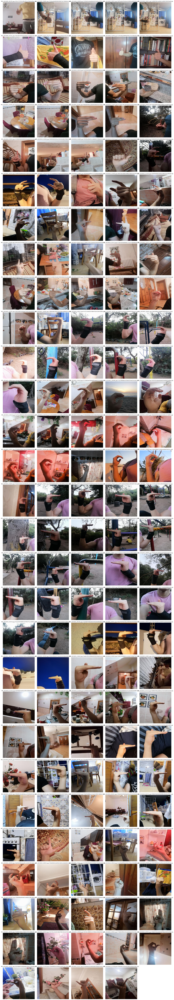

In [8]:
cols = 5
num_images = len(not_detected_images)
rows = math.ceil(num_images / cols)

plt.figure(figsize=(20, rows * 4))

for idx, img_path in enumerate(not_detected_images):
    img = cv2.imread(img_path)
    if img is not None:
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.subplot(rows, cols, idx + 1)
        plt.imshow(img_rgb)
        plt.title(os.path.basename(img_path), fontsize=8)
        plt.axis('off')

plt.tight_layout()
plt.show()

## Statistical Analysis of Failed Images

In this section, several statistical features are extracted from images where hand detection failed.

Extracted features include:
- Image dimensions and aspect ratio
- Brightness and intensity variance
- Edge strength and edge density (using Sobel filter)
- Color variance across RGB channels

These features help analyze why MediaPipe fails on certain images.


###### Stolen from Abu Al-Sayed

In [9]:
stats_failed = []

for img_path in tqdm(not_detected_images, desc="Processing failed images"):
    img = cv2.imread(str(img_path))

    if img is None:
        stats_failed.append({
            "filename": os.path.basename(img_path),
            "path": str(img_path),
            "error": "Invalid image"
        })
        continue

    h, w, c = img.shape

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


    edges = filters.sobel(gray)

    stats_failed.append({
        "filename": os.path.basename(img_path),
        "height": h,
        "width": w,
        "channels": c,
        "brightness": gray.mean(),
        "edge_strength": edges.mean(),
        "aspect_ratio": w / h,
        "variance": gray.var(),
        "edge_density": (edges > 0.1).sum() / edges.size,
        "color_variance": img.reshape(-1, 3).var(axis=0).mean(),
    })


df_stats_failed = pd.DataFrame(stats_failed)

df_stats_failed.head(10)

Processing failed images:   1%|          | 1/144 [00:00<00:16,  8.47it/s]

Processing failed images: 100%|██████████| 144/144 [00:02<00:00, 64.49it/s]


,filename,height,width,channels,brightness,edge_strength,aspect_ratio,variance,edge_density,color_variance
0,IMG_20210609_185709_jpg.rf.631c7371911208c5f51...,416,416,3,132.653771,0.022275,1.0,2944.493193,0.044327,3032.408041
1,IMG_20210609_190858_jpg.rf.910beb666f605893946...,416,416,3,148.977753,0.032220,1.0,2507.303673,0.093444,2726.382118
2,IMG_20210609_190908_jpg.rf.cf834a53e4ed68a5d59...,416,416,3,145.542610,0.038715,1.0,2935.079256,0.114945,3010.653280
3,IMG_20210609_190912_jpg.rf.d0f7aa0ed31b4eee162...,416,416,3,142.873082,0.041723,1.0,2444.249933,0.126369,2535.295688
4,IMG_20210609_190923_jpg.rf.a066019dc1a669a7e48...,416,416,3,152.973379,0.036336,1.0,1646.609470,0.104354,1898.144796
5,IMG_20210609_191131_jpg.rf.d1b146c8cfe56533640...,416,416,3,159.432918,0.023706,1.0,2184.754318,0.041068,2397.582278
6,IMG_20210609_191331_jpg.rf.377c0cd5dac1593aaa1...,416,416,3,126.463913,0.050280,1.0,3550.646800,0.147449,3902.628777
7,IMG_20210609_191444_jpg.rf.e8ae80bf4e597c0b7a8...,416,416,3,113.858364,0.029918,1.0,2893.347618,0.076888,2925.863927
8,IMG_20210609_192406_jpg.rf.c975440ed4889da93bc...,416,416,3,123.887239,0.023271,1.0,2088.129320,0.054063,2303.819405
9,IMG_20210610_174514_jpg.rf.286fb9d3deb62c520d5...,416,416,3,85.599436,0.043512,1.0,2122.184974,0.125589,2245.784817


In [ ]:
df_stats_failed.to_csv("../reports/failed_images_stats_mp.csv", index=False)

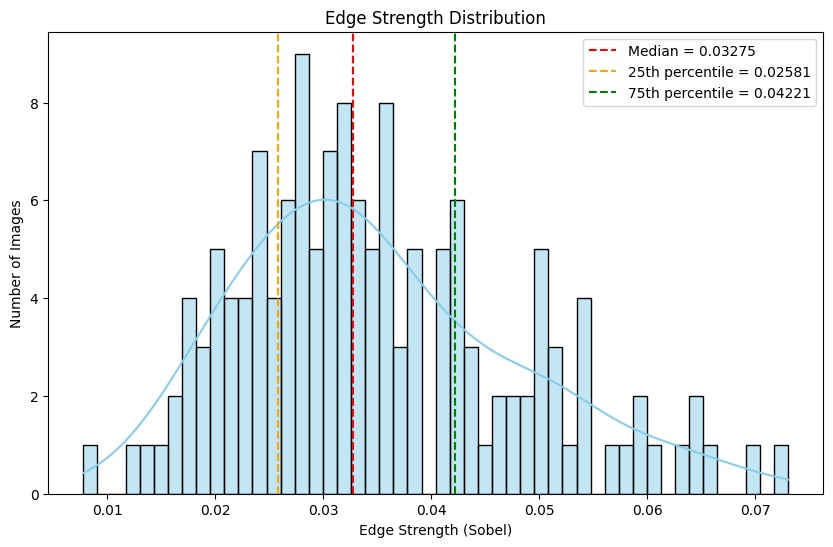

In [11]:
plt.figure(figsize=(10,6))

# Histogram + KDE
sns.histplot(df_stats_failed['edge_strength'], bins=50, kde=True, color='skyblue')
plt.axvline(df_stats_failed['edge_strength'].median(), color='red', linestyle='--', label=f"Median = {df_stats_failed['edge_strength'].median():.5f}")
plt.axvline(df_stats_failed['edge_strength'].quantile(0.25), color='orange', linestyle='--', label=f"25th percentile = {df_stats_failed['edge_strength'].quantile(0.25):.5f}")
plt.axvline(df_stats_failed['edge_strength'].quantile(0.75), color='green', linestyle='--', label=f"75th percentile = {df_stats_failed['edge_strength'].quantile(0.75):.5f}")

plt.title("Edge Strength Distribution")
plt.xlabel("Edge Strength (Sobel)")
plt.ylabel("Number of Images")
plt.legend()
plt.show()


## Image Preprocessing & Enhancement Pipeline (Summary)

The following summarizes the filtering and enhancement steps used to improve image quality before hand-detection:

### **1. Resize (Normalization)**
All images are resized to a fixed resolution (e.g., **256×256**) to ensure consistent input size for the model and preprocessing pipeline.

### **2. LAB Color Space Conversion**
Images are converted from **BGR → LAB**, because the *L-channel* represents lightness and allows better contrast manipulation.

### **3. CLAHE (Contrast Limited Adaptive Histogram Equalization)**
Applied only to the **L channel** to:
- Increase contrast in low-contrast images  
- Reveal hidden edges and hand details  
- Avoid over-amplifying noise thanks to the "limited" part

### **4. Gamma Correction**
Gamma \(> 1\) slightly brightens dark images without blowing out highlights.  
This helps MediaPipe recognize faint hand shapes.

### **5. Denoising (Non-Local Means)**
Removes noise using **fastNlMeansDenoisingColored**, which:
- Smooths unwanted grain  
- Preserves edges and hand boundaries

### **6. Sharpening**
A custom sharpening kernel enhances:
- Edges  
- Finger contours  
- Hand boundaries  
It increases the clarity of hand shapes for detection.

### **7. Bilateral Filtering**
A smoothing filter that:
- Removes noise  
- Keeps edges *sharp* (unlike Gaussian blur)  
Perfect for hand detection where edge clarity matters.

---

## **Optional Data Augmentations**

### **1. Random Horizontal Flip**
Simulates left/right hand variations to make the dataset more diverse.

### **2. Random Rotation (−15° to +15°)**
Adds small rotations to help the model handle tilted hands.

---

## **Final Output**
After all steps, the result is:
- Sharper  
- More contrasted  
- Cleaner  
- Better exposed  
- More consistent  
- Augmented (if enabled)

This leads to improved robustness when applying hand-detection models like MediaPipe.


In [12]:
failed_images = not_detected_images 

In [13]:
processed_root = "processed"
os.makedirs(processed_root, exist_ok=True)

processed_count = 0
failed_count = 0

In [ ]:
def enhance_image(img, augment=True, output_size=(256, 256)):
    """
    Enhance image for hand detection:
    - Contrast improvement (soft CLAHE)
    - Mild gamma correction
    - Histogram normalization (very important)
    - Smart denoising
    - Gentle sharpening
    - Optional augmentations (flip + slight rotation)
    """

    img_resized = cv2.resize(img, output_size)

    # ---------------------------
    # LAB + Soft CLAHE
    # ---------------------------
    lab = cv2.cvtColor(img_resized, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)

    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    l_clahe = clahe.apply(l)

    lab_clahe = cv2.merge((l_clahe, a, b))
    img_clahe = cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2BGR)

    # ---------------------------
    # Gamma correction
    # ---------------------------
    gamma = 1.05   
    invGamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** invGamma) * 255
                    for i in np.arange(256)]).astype("uint8")
    img_gamma = cv2.LUT(img_clahe, table)

    # ---------------------------
    # Histogram Normalization
    # ---------------------------
    img_norm = cv2.normalize(img_gamma, None, 0, 255, cv2.NORM_MINMAX)

    # ---------------------------
    # Denoising 
    # ---------------------------
    img_denoised = cv2.fastNlMeansDenoisingColored(
        img_norm, None,
        h=5, hColor=5,     
        templateWindowSize=7,
        searchWindowSize=21
    )

    # ---------------------------
    # Gentle Sharpening
    # ---------------------------
    kernel = np.array([
        [0, -0.5, 0],
        [-0.5, 4, -0.5],
        [0, -0.5, 0]
    ])
    img_sharp = cv2.filter2D(img_denoised, -1, kernel)

    # ---------------------------
    # Bilateral Filter 
    # ---------------------------
    img_filtered = cv2.bilateralFilter(img_sharp, 5, 50, 50)

    # ---------------------------
    # Augmentations
    # ---------------------------
    if augment:
        if np.random.rand() > 0.5:
            img_filtered = cv2.flip(img_filtered, 1)  

        angle = np.random.uniform(-8, 8)
        h, w = img_filtered.shape[:2]
        M = cv2.getRotationMatrix2D((w//2, h//2), angle, 1.0)
        img_filtered = cv2.warpAffine(
            img_filtered, M, (w, h),
            flags=cv2.INTER_LINEAR,
            borderMode=cv2.BORDER_REPLICATE
        )

    return img_filtered


## Reprocessing Failed Images and Hand Detection Re-evaluation

This section applies the enhancement pipeline to previously failed images and runs MediaPipe again.

- Enhanced images are saved in a new directory.
- MediaPipe is reapplied to measure improvement.
- Detection success and failure rates are recalculated and compared.

This step validates the effectiveness of the preprocessing pipeline.


In [15]:
for img_path in failed_images:
    img_name = os.path.basename(img_path)
    parent_folder = os.path.basename(os.path.dirname(img_path))
    save_folder = os.path.join(processed_root, parent_folder)
    os.makedirs(save_folder, exist_ok=True)
    
    img = cv2.imread(img_path)
    if img is None:
        print(f"Failed to read: {img_name}")
        failed_count += 1
        continue
    
    img_filtered = enhance_image(img)
    
    save_path = os.path.join(save_folder, img_name)
    cv2.imwrite(save_path, img_filtered)
    processed_count += 1

print("-" * 30)
print(f"Total processed images: {processed_count}")
print(f"Images failed to read: {failed_count}")
print("-" * 30)


------------------------------
Total processed images: 144
Images failed to read: 0
------------------------------


In [16]:
processed_path = r"processed"  

image_paths = []
for root, dirs, files in os.walk(processed_path):
    for f in files:
        if f.lower().endswith((".jpg", ".jpeg", ".png")):
            image_paths.append(os.path.join(root, f))

print(f"Total processed images found: {len(image_paths)}")

Total processed images found: 144


In [17]:
detected_processed = []
not_detected_processed = []


In [18]:
for img_path in image_paths:
    img = cv2.imread(img_path)
    if img is None:
        print(f"Cannot read: {img_path}")
        continue

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    results = hands.process(img_rgb)

    if results.multi_hand_landmarks:
        detected_processed.append(img_path)
    else:
        not_detected_processed.append(img_path)

print("-" * 40)
print(f"Detected (processed): {len(detected_processed)}")
print(f"NOT Detected (processed): {len(not_detected_processed)}")
print(f"Failure Rate (processed): {len(not_detected_processed)/len(image_paths)*100:.2f}%")
print("-" * 40)

----------------------------------------
Detected (processed): 35
NOT Detected (processed): 109
Failure Rate (processed): 75.69%
----------------------------------------


In [20]:
processed_stats_failed = []

for img_path in tqdm(not_detected_processed, desc="Processing failed images"):
    img = cv2.imread(str(img_path))

    if img is None:
        processed_stats_failed.append({
            "filename": os.path.basename(img_path),
            "path": str(img_path),
            "error": "Invalid image"
        })
        continue

    h, w, c = img.shape

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


    edges = filters.sobel(gray)

    processed_stats_failed.append({
        "filename": os.path.basename(img_path),
        "height": h,
        "width": w,
        "channels": c,
        "brightness": gray.mean(),
        "edge_strength": edges.mean(),
        "aspect_ratio": w / h,
        "variance": gray.var(),
        "edge_density": (edges > 0.1).sum() / edges.size,
        "color_variance": img.reshape(-1, 3).var(axis=0).mean(),
    })


df_processed_stats_failed = pd.DataFrame(processed_stats_failed)

df_processed_stats_failed.head(10)

Processing failed images: 100%|██████████| 109/109 [00:00<00:00, 130.74it/s]


,filename,height,width,channels,brightness,edge_strength,aspect_ratio,variance,edge_density,color_variance
0,IMG_20210609_190908_jpg.rf.cf834a53e4ed68a5d59...,256,256,3,211.636887,0.065220,1.0,3874.774505,0.215286,3996.886012
1,IMG_20210609_190912_jpg.rf.d0f7aa0ed31b4eee162...,256,256,3,214.472641,0.080704,1.0,3842.202254,0.254364,3987.370265
2,IMG_20210609_190923_jpg.rf.a066019dc1a669a7e48...,256,256,3,225.923965,0.061802,1.0,2712.256655,0.208923,2933.386566
3,IMG_20210609_191131_jpg.rf.d1b146c8cfe56533640...,256,256,3,230.514725,0.027677,1.0,2090.882992,0.086090,2124.931270
4,IMG_20210609_191331_jpg.rf.377c0cd5dac1593aaa1...,256,256,3,190.212448,0.088701,1.0,5133.321061,0.320877,5784.662544
5,IMG_20210609_191444_jpg.rf.e8ae80bf4e597c0b7a8...,256,256,3,194.599518,0.062263,1.0,3109.827804,0.204544,3325.265357
6,IMG_20210609_192406_jpg.rf.c975440ed4889da93bc...,256,256,3,217.147064,0.050451,1.0,3065.257394,0.163467,3272.720449
7,IMG_20210624_215843_jpg.rf.06b31fd3b69c4a3274e...,256,256,3,169.417877,0.102311,1.0,6510.651398,0.352509,6668.344631
8,IMG_20210624_215901_jpg.rf.2c3a232be8f06fa8483...,256,256,3,179.958466,0.097327,1.0,5512.644973,0.328781,5644.185948
9,IMG_20210624_220529_jpg.rf.e43f10b3f48474201b9...,256,256,3,208.303650,0.037560,1.0,5201.381979,0.116592,5369.739414


## Hand Region Cropping Using MediaPipe Landmarks

In this final preprocessing step, detected hand landmarks are used to crop the hand region.

- A bounding box is computed around hand landmarks.
- A small margin is added to avoid cutting important regions.
- Cropped hand images are resized to **128×128**.
- Images are saved class-wise for CNN training.

This produces a clean and standardized dataset ready for deep learning.


In [ ]:
processed_cropped = os.path.join("..", "data", "processed", "processed_cropped_mp")
os.makedirs(processed_cropped, exist_ok=True)

all_detected_images = detected_images + detected_processed  # 4507 + 35 

for img_path in all_detected_images:
    img_name = os.path.basename(img_path)
    parent_folder = os.path.basename(os.path.dirname(img_path))  
    save_folder = os.path.join(processed_cropped, parent_folder)
    os.makedirs(save_folder, exist_ok=True)

    img = cv2.imread(img_path)
    if img is None:
        print(f"Cannot read: {img_name}")
        continue

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    results = hands.process(img_rgb)

    if results.multi_hand_landmarks:
        hand_landmarks = results.multi_hand_landmarks[0]

        h, w, _ = img.shape
        x_coords = [int(lm.x * w) for lm in hand_landmarks.landmark]
        y_coords = [int(lm.y * h) for lm in hand_landmarks.landmark]

        x_min, x_max = max(min(x_coords) - 10, 0), min(max(x_coords) + 10, w)
        y_min, y_max = max(min(y_coords) - 10, 0), min(max(y_coords) + 10, h)

        hand_crop = img[y_min:y_max, x_min:x_max]

        hand_crop = cv2.resize(hand_crop, (128, 128))

        save_path = os.path.join(save_folder, img_name)
        cv2.imwrite(save_path, hand_crop)
    else:
        print(f"No hand detected in {img_name}")


## Conclusion

This notebook presented a complete preprocessing pipeline for hand gesture recognition using MediaPipe.

Starting from raw images, we performed:
- Hand detection analysis
- Failure diagnosis and visualization
- Image enhancement for difficult cases
- Landmark-based hand cropping

The final output is a high-quality dataset optimized for CNN-based gesture classification.
